In [ ]:
!pip install torch torchvision matplotlib onnx tqdm numpy

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 47.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 24.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 14.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 7.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 12.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 6.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 80.8 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstalling nvidia-nvjitlink-cu12-12.5.82:
      Successfully uninstalled nvidia-nvjitlin

In [ ]:
import torch
import torchvision
from torchvision import transforms
from torchvision.datasets import VOCSegmentation
from torchvision.models.segmentation import deeplabv3_mobilenet_v3_large
from torchvision import transforms
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
import onnx
import torchvision.transforms.functional as TF
from tqdm import tqdm
import numpy as np

In [ ]:
transform = transforms.Compose([
    transforms.Resize((256, 256)),
    transforms.ToTensor(),
])

def mask_transform(mask):
    mask = TF.resize(mask, (256, 256))
    mask = TF.pil_to_tensor(mask)  # shape: [1, H, W]
    return mask.squeeze(0)         # shape: [H, W]

In [ ]:
train_dataset = VOCSegmentation(
    root="./data",
    year="2012",
    image_set="train",
    download=True,
    transform=transform,
    target_transform=mask_transform
)

train_loader = DataLoader(train_dataset, batch_size=4, shuffle=True)



100%|██████████| 2.00G/2.00G [01:11<00:00, 27.9MB/s]


In [3]:
model = deeplabv3_mobilenet_v3_large(pretrained=True)
model.classifier[4] = torch.nn.Conv2d(256, 2, kernel_size=1)  # binary classes: person vs background

model = model.to("cuda" if torch.cuda.is_available() else "cpu")


/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DeepLabV3_MobileNet_V3_Large_Weights.COCO_WITH_VOC_LABELS_V1`. You can also use `weights=DeepLabV3_MobileNet_V3_Large_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/deeplabv3_mobilenet_v3_large-fc3c493d.pth" to /root/.cache/torch/hub/checkpoints/deeplabv3_mobilenet_v3_large-fc3c493d.pth
100%|██████████| 42.3M/42.3M [00:00<00:00, 153MB/s]


In [4]:
criterion = torch.nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)
device = "cuda" if torch.cuda.is_available() else "cpu"

In [ ]:
def train(model, loader):
    model.train()
    total_loss = 0
    pbar = tqdm(loader, desc="Training", leave=False)
    for imgs, masks in pbar:
        imgs = imgs.to(device)
        masks = masks.to(device)

        # VOC label for "person" is 15 → convert to binary mask
        masks = (masks == 15).long()  # shape: [B, H, W]
        output = model(imgs)['out']  # [B, 2, H, W]
        loss = criterion(output, masks)

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        total_loss += loss.item()

        pbar.set_postfix(loss=loss.item())

    print(f"Train loss: {total_loss / len(loader):.4f}")

for epoch in range(3):
    print(f"Epoch {epoch+1}")
    train(model, train_loader)


Epoch 1


Train loss: 0.1764
Epoch 2


Train loss: 0.0679
Epoch 3


Train loss: 0.0508


In [ ]:
transform = transforms.Compose([
    transforms.Resize(320),               # Resize shortest side to 320 (keeps aspect ratio)
    transforms.CenterCrop((320, 320)),   # Crop to 320x320 square
    transforms.ToTensor(),
])

In [ ]:
val_dataset = VOCSegmentation(
    root="./data",
    year="2012",
    image_set="val",
    download=True,
    transform=transform,
    target_transform=lambda x: x
)

val_loader = DataLoader(val_dataset, batch_size=4, shuffle=False)

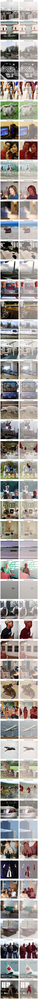

In [ ]:
def visualize_prediction(model, dataset, num_images=5):
    fig, axs = plt.subplots(num_images, 2, figsize=(8, num_images * 4))
    model.eval()
    for i in range(num_images):
        img, _ = dataset[i]
        input_tensor = img.unsqueeze(0).to(device)

        with torch.no_grad():
            output = model(input_tensor)['out']
            pred_mask = torch.argmax(output.squeeze(), dim=0).cpu().numpy()  # [H, W]
            
        binary_mask = (pred_mask == 1).astype(np.uint8)  # 0 = background, 1 = person
        img_np = img.permute(1, 2, 0).numpy()

        axs[i, 0].imshow(img_np)
        axs[i, 0].set_title("Original Image")
        axs[i, 0].axis("off")

        axs[i, 1].imshow(img_np)
        axs[i, 1].imshow(binary_mask, alpha=0.5, cmap='Reds')  # Overlay mask
        axs[i, 1].set_title("Predicted Person Mask")
        axs[i, 1].axis("off")

    plt.tight_layout()
    plt.show()

visualize_prediction(model, val_dataset, num_images=50)


In [ ]:
dummy_input = torch.randn(1, 3, 256, 256).to(device)  # input shape used in training
model.eval()
torch.onnx.export(
    model,
    dummy_input,
    "human_segmentation.onnx",
    input_names=["input"],
    output_names=["output"],
    opset_version=11,
)

print("ONNX model exported!")

ONNX model exported!


In [ ]:
torch.save(model.state_dict(), "human_segmentation_deeplabv3.pth")
